## Codebook Analysis

To further analyse the latent space, this notebook serves as a fast way to gain information in the following areas:

- Codebook usage and Entropy
- Latent space visualization with dimensionality reduction methods t-SNE and PCA
- Individual codebook vector usage
- Failure analysis with respect to stability and misclassification rate under adversarial perturbations
- Combination of failure rates with visualizations and codebook vector usage


Set paths and model mapping according to needs!

Some code repeats itself to enable individual analysis within the respective section without running the whole codebook.

### Models and Encoding

First, models are loaded and mapped to cleaner, less functional names from the training process. After, the respective encodings are generated.


Most cell outputs deprecated due to file size concerns.

In [11]:
# import necessary modules
import os
import re
import torch
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from scipy.stats import entropy
from sklearn.manifold import TSNE
from sklearn.decomposition import PCA
from torchvision import datasets, transforms
from torch.utils.data import DataLoader
import torch.nn.functional as F
import torchattacks

In [ ]:
# set paths and info for model loading
MODEL_PATH = "best_model/latent_analysis2"
batch_size = 64

In [ ]:
import os
import re
import torch

# function to dynamically load the correct S-VQVAE class
def get_s_vqvae_model_class(model_path):
    """
    Dynamically import and return the appropriate S-VQVAE model class based on the filename.
    """
    if "pretrainedvgg16_256" in model_path:
        module = __import__("models.pretrainedvgg16_256", fromlist=['S_VQVAE_VGG'])
        return module.S_VQVAE_VGG
    
    # extract the codebook vector size from the filename
    match = re.search(r"emb(\d+)", model_path)
    if not match:
        raise ValueError(f"Could not find codebook vector size in filename: {model_path}")
    
    emb_size = match.group(1)

    # map the size to the appropriate module and class import
    model_imports = {
        "512": "models.s_vqvae_emb512",
        "256": "models.s_vqvae_emb256",
        "128": "models.s_vqvae_emb128",
        "64": "models.s_vqvae_emb64",
        "10": "models.s_vqvae_emb10"
    }

    if emb_size not in model_imports:
        raise ValueError(f"Unsupported codebook vector size: {emb_size}")

    module_name = model_imports[emb_size]
    module = __import__(module_name, fromlist=['S_VQVAE'])
    return module.S_VQVAE

# load models
model_files = [f for f in os.listdir(MODEL_PATH) if f.endswith('.pt')]
models = {}

for file in model_files:
    model_name = file.replace('.pt', '')
    
    # dynamically get the correct S_VQVAE class
    try:
        S_VQVAE_Class = get_s_vqvae_model_class(file)
        model = S_VQVAE_Class()
        
        # load state dict
        checkpoint = torch.load(os.path.join(MODEL_PATH, file), map_location=torch.device('cpu'))
        model_state_dict = checkpoint['state_dict'] if 'state_dict' in checkpoint else checkpoint
        model.load_state_dict(model_state_dict, strict=False)
        model.eval()
        
        models[model_name] = model
        print(f"Successfully loaded {model_name}")
        
    except Exception as e:
        print(f"Failed to load {model_name}: {e}")

print(f"Loaded models: {list(models.keys())}")


Successfully loaded svqvae_cd_delayedat_emb256_marginchange_lr05
Successfully loaded svqvae_emb10_cd_limit3
Successfully loaded svqvae_emb10_marginbased05_015_gamma0.1
Successfully loaded svqvae_emb256
Successfully loaded svqvae_emb256_cd_marginbased05_15_gamma0.1
Successfully loaded svqvae_emb256_delayedat
Loaded models: ['svqvae_cd_delayedat_emb256_marginchange_lr05', 'svqvae_emb10_cd_limit3', 'svqvae_emb10_marginbased05_015_gamma0.1', 'svqvae_emb256', 'svqvae_emb256_cd_marginbased05_15_gamma0.1', 'svqvae_emb256_delayedat']


C:\Users\joopt\AppData\Local\Temp\ipykernel_513644\1762987916.py:50: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  checkpoint = torch.load(os.path.join(MODEL_PATH, file), ma

In [ ]:
# create a mapping of the original names to your desired names.
custom_names = {
    'svqvae_cd_delayedat_emb256_marginchange_lr05': 'SVQVAE256 DelayedAT CD',
    'svqvae_emb10_cd_limit3': 'SVQVAE10',
    'svqvae_emb10_marginbased05_015_gamma0.1': 'SVQVAE10 CD',
    'svqvae_emb256_cd_marginbased05_15_gamma0.1': 'SVQVAE256 CD',
    'svqvae_emb256_delayedat': 'SVQVAE256 DelayedAT',
    'svqvae_emb256': 'SVQVAE256'
    # add other mappings as needed.
}

# create a new dictionary with the custom names.
renamed_models = {}
for old_name, model in models.items():
    # use the new name if provided, otherwise keep the original name.
    new_name = custom_names.get(old_name, old_name)
    renamed_models[new_name] = model

# replace the original models dictionary.
models = renamed_models

print(f"Renamed models: {list(models.keys())}")

Renamed models: ['SVQVAE256 DelayedAT CD', 'SVQVAE10', 'SVQVAE10 CD', 'SVQVAE256', 'SVQVAE256 CD', 'SVQVAE256 DelayedAT']


In [15]:
# test data loader for CIFAR-10
def get_test_loader(batch_size=64):
    """
    Prepare the CIFAR-10 test dataset DataLoader.

    Args:
        batch_size (int): Batch size for DataLoader.

    Returns:
        DataLoader: DataLoader for the CIFAR-10 test dataset.
    """
    transform = transforms.Compose([
        transforms.ToTensor(),
        transforms.Normalize([0.5, 0.5, 0.5], [0.5, 0.5, 0.5]),
    ])
    test_dataset = datasets.CIFAR10(root="./cifar10", train=False, download=True, transform=transform)
    return DataLoader(test_dataset, batch_size=batch_size, shuffle=False, num_workers=2)

In [16]:
data_loader = get_test_loader(batch_size=batch_size)

Files already downloaded and verified


In [ ]:
# function to extract the respective latent codes of the models
def get_latent_codes(model, data_loader):
    all_codes = []
    all_labels = []
    all_codes = []
    with torch.no_grad():
        for x, labels in data_loader:
            all_labels.append(labels.cpu().numpy())
            _, _, latent_codes = model.encode(x)
            all_codes.append(latent_codes.cpu().numpy())
    return np.concatenate(all_codes, axis=0), np.concatenate(all_labels, axis=0)

### Codebook Usage and Visualization of Latent Space

The Latent space is first analyse by showing the codebook Usage and utilized clusters with entropy.

Additionally the vector's dimensionality is reduced with t-SNE, PCA.

In [ ]:
def analyze_codebook_usage(latent_codes, labels, model, model_name):
    # define the CIFAR-10 class names.
    cifar10_classes = ["airplane", "automobile", "bird", "cat", "deer",
                       "dog", "frog", "horse", "ship", "truck"]

    # define colors
    tab10_colors = [
        "#1f77b4",  # blue
        "#ff7f0e",  # orange
        "#2ca02c",  # green
        "#d62728",  # red
        "#9467bd",  # purple
        "#8c564b",  # brown
        "#e377c2",  # pink
        "#7f7f7f",  # gray
        "#bcbd22",  # olive
        "#17becf"   # cyan
    ]

    # compute unique codes and codebook usage count per class.
    unique_codes = np.unique(latent_codes)
    codebook_usage_count = [] 
    for label in range(10):
        label_codes = latent_codes[labels == label].flatten()
        codes_used = np.unique(label_codes)
        codebook_usage_count.append(len(codes_used))
    
    # compute frequency of codebook entries per class.
    label_counts = {label: np.zeros(len(unique_codes)) for label in range(10)}
    for code, label in zip(latent_codes.flatten(), labels.flatten()):
        idx = np.where(unique_codes == code)[0][0]
        label_counts[label][idx] += 1

    # create a figure with two subplots (1 row, 2 columns)
    fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(15, 5))
    
    # first subplot: number of codebooks used per class.
    axes[0].bar(range(10), codebook_usage_count, color=tab10_colors)
    axes[0].set_xticks(range(10))
    axes[0].set_xticklabels(cifar10_classes, rotation=45)
    axes[0].set_xlabel("Class")
    axes[0].set_ylabel("Number of Codebook Vectors Used")
    axes[0].set_title(f"(a) Number of Codebook Vectors Used per Class - {model_name}")
    
    # second subplot: frequency of codebook entries per class.
    bar_width = 0.1
    x = np.arange(len(unique_codes))
    for label, counts in label_counts.items():
        axes[1].bar(x + label * bar_width, counts, width=bar_width, 
                    label=f"{cifar10_classes[label]}", color=tab10_colors[label])
    axes[1].set_xlabel("Codebook Entry")
    axes[1].set_ylabel("Usage Count")
    axes[1].set_title(f"(b) Codebook Usage - {model_name}")
    axes[1].legend(loc="upper right", ncol=2, framealpha=0.8)
    
    plt.tight_layout()
    plt.show()
    
    print(f"Count Codebook Vector Usage for {model_name}:")
    print(f"Total unique codes used: {len(unique_codes)}")
    print(f"Total codebook size: {model.quantize.embed.shape[1]}")


In [ ]:
for model_name, model in models.items():
    print(f"\nAnalyzing model: {model_name}")
    latent_codes, labels = get_latent_codes(model, data_loader)
    analyze_codebook_usage(latent_codes, labels, model, model_name)

In [ ]:
import pandas as pd

# create an empty DataFrame with the required columns.
stats_df = pd.DataFrame(columns=["Model", "Total Codebook size", "Unique Codes Used"])

In [22]:
for model_name, model in models.items():
    print(f"\nAnalyzing model: {model_name}")
    latent_codes, labels = get_latent_codes(model, data_loader)
    stats_df = analyze_codebook_usage_table(latent_codes, labels, model, model_name, stats_df)

# After processing all models, display the table.
stats_df


Analyzing model: SVQVAE256 DelayedAT CD

Analyzing model: SVQVAE10

Analyzing model: SVQVAE10 CD

Analyzing model: SVQVAE256

Analyzing model: SVQVAE256 CD

Analyzing model: SVQVAE256 DelayedAT


,Model,Total Codebook size,Unique Codes Used
0,SVQVAE256 DelayedAT CD,256,256
1,SVQVAE10,10,10
2,SVQVAE10 CD,10,10
3,SVQVAE256,256,256
4,SVQVAE256 CD,256,256
5,SVQVAE256 DelayedAT,256,256


In [ ]:
import math
import numpy as np
import matplotlib.pyplot as plt
from scipy.stats import entropy

# entropy per class
def entropy_analysis_models(model_data, ncols=3):

    cifar10_classes = ["airplane", "automobile", "bird", "cat", "deer",
                       "dog", "frog", "horse", "ship", "truck"]

    tab10_colors = [
        "#1f77b4",  # blue
        "#ff7f0e",  # orange
        "#2ca02c",  # green
        "#d62728",  # red
        "#9467bd",  # purple
        "#8c564b",  # brown
        "#e377c2",  # pink
        "#7f7f7f",  # gray
        "#bcbd22",  # olive
        "#17becf"   # cyan
    ]

    # precompute entropies for each model and determine the global maximum.
    model_entropies = {}  # model_name -> list of 10 entropies
    global_max = 0
    for model_name, (latent_codes, labels) in model_data.items():
        unique_codes = np.unique(latent_codes)
        entropies = []
        for label in range(10):
            label_codes = latent_codes[labels == label].flatten()
            counts = np.array([np.sum(label_codes == code) for code in unique_codes])
            counts = counts / np.sum(counts)
            ent = entropy(counts, base=2)
            entropies.append(ent)
        model_entropies[model_name] = entropies
        global_max = max(global_max, max(entropies))
    
    # create subplots with the same y-scale.
    nmodels = len(model_data)
    nrows = math.ceil(nmodels / ncols)
    fig, axes = plt.subplots(nrows=nrows, ncols=ncols, figsize=(5 * ncols, 4 * nrows))
    
    if nmodels == 1:
        axes = [axes]
    else:
        axes = axes.flatten()

    # plot each model's entropy in its own subplot.
    for i, (model_name, entropies) in enumerate(model_entropies.items()):
        ax = axes[i]
        ax.bar(range(10), entropies, color=tab10_colors)
        ax.set_xticks(range(10))
        ax.set_xticklabels(cifar10_classes, rotation=45)
        ax.set_xlabel("Class")
        ax.set_ylabel("Entropy")
        ax.set_title(model_name)
        ax.set_ylim(0, global_max * 1.1) 

    # turn off any extra subplots.
    for j in range(i+1, len(axes)):
        axes[j].axis("off")
    
    fig.suptitle("Entropy of Codebook Usage per Class", fontsize=16)
    plt.tight_layout(rect=[0, 0, 1, 0.95])
    plt.show()

    for model_name, entropies in model_entropies.items():
        entropy_dict = {cifar10_classes[i]: entropies[i] for i in range(10)}
        print(f"Entropy per class for {model_name}:")
        for cls, ent in entropy_dict.items():
            print(f"  {cls}: {ent:.2f}")
        print()




Analyzing model: SVQVAE256 DelayedAT CD

Analyzing model: SVQVAE10

Analyzing model: SVQVAE10 CD

Analyzing model: SVQVAE256

Analyzing model: SVQVAE256 CD

Analyzing model: SVQVAE256 DelayedAT


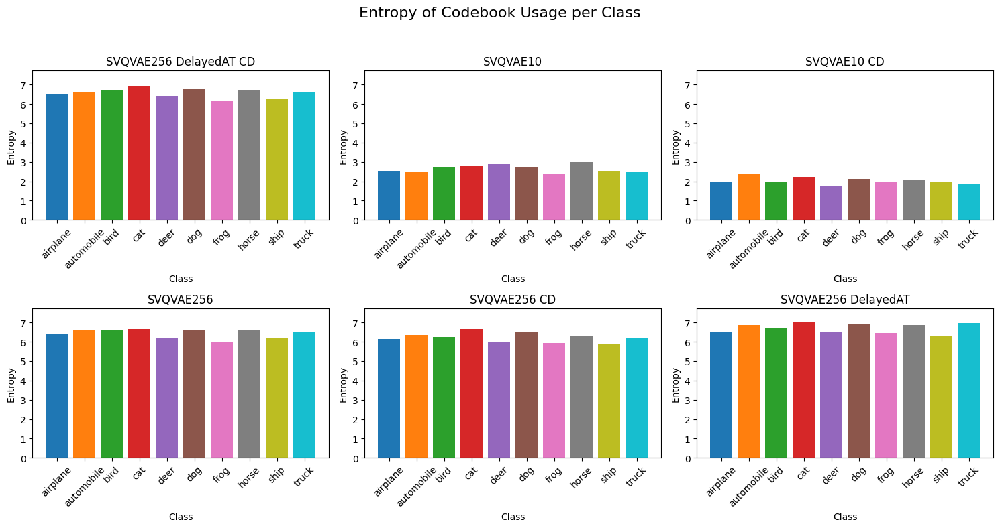

Entropy per class for SVQVAE256 DelayedAT CD:
  airplane: 6.50
  automobile: 6.62
  bird: 6.73
  cat: 6.93
  deer: 6.38
  dog: 6.76
  frog: 6.14
  horse: 6.70
  ship: 6.25
  truck: 6.59

Entropy per class for SVQVAE10:
  airplane: 2.55
  automobile: 2.50
  bird: 2.76
  cat: 2.78
  deer: 2.88
  dog: 2.73
  frog: 2.37
  horse: 2.98
  ship: 2.54
  truck: 2.52

Entropy per class for SVQVAE10 CD:
  airplane: 1.97
  automobile: 2.38
  bird: 1.99
  cat: 2.23
  deer: 1.74
  dog: 2.12
  frog: 1.96
  horse: 2.04
  ship: 1.97
  truck: 1.89

Entropy per class for SVQVAE256:
  airplane: 6.39
  automobile: 6.63
  bird: 6.61
  cat: 6.66
  deer: 6.18
  dog: 6.61
  frog: 5.96
  horse: 6.61
  ship: 6.19
  truck: 6.49

Entropy per class for SVQVAE256 CD:
  airplane: 6.14
  automobile: 6.34
  bird: 6.25
  cat: 6.67
  deer: 5.99
  dog: 6.47
  frog: 5.93
  horse: 6.29
  ship: 5.85
  truck: 6.22

Entropy per class for SVQVAE256 DelayedAT:
  airplane: 6.54
  automobile: 6.88
  bird: 6.74
  cat: 7.02
  deer: 6

In [ ]:
# create an empty dictionary to hold the data.
model_data = {}

for model_name, model in models.items():
    print(f"\nAnalyzing model: {model_name}")
    latent_codes, labels = get_latent_codes(model, data_loader)
    model_data[model_name] = (latent_codes, labels)

# call the function to plot entropy for all models with 3 columns per row
entropy_analysis_models(model_data, ncols=3)

In [ ]:
# function for latent space visualization
def visualize_latent_space(latent_codes, labels, model_name, method='tsne'):
    if method == 'tsne':
        reducer = TSNE(n_components=2, perplexity=30, random_state=42)
    else:
        reducer = PCA(n_components=2)
    
    latent_2d = reducer.fit_transform(latent_codes.reshape(latent_codes.shape[0], -1))
    
    plt.figure(figsize=(8, 6))
    scatter = plt.scatter(latent_2d[:, 0], latent_2d[:, 1], c=labels, cmap='tab10', s=5, alpha=0.5)
    plt.legend(*scatter.legend_elements(), title="Classes")
    plt.title(f"{method.upper()} Visualization of Latent Space - {model_name}")
    plt.xlabel("Component 1")
    plt.ylabel("Component 2")
    plt.show()

In [ ]:
# run analysis codebook with visualization
for model_name, model in models.items():
    print(f"\nAnalyzing model: {model_name}")
    latent_codes, labels = get_latent_codes(model, data_loader)
    analyze_codebook_usage(latent_codes, labels, model_name)
for model_name, model in models.items():
    print(f"\nAnalyzing model: {model_name}")
    latent_codes, labels = get_latent_codes(model, data_loader)
    visualize_latent_space(latent_codes, labels, model_name, method='tsne')
for model_name, model in models.items():
    print(f"\nAnalyzing model: {model_name}")
    latent_codes, labels = get_latent_codes(model, data_loader)
    visualize_latent_space(latent_codes, labels, model_name, method='PCA')


### Codebook Vectors

Now let's analyze to individual codebook vector usage.

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.stats import entropy

def codebook_entropy_variation(latent_codes, model_name):
    """
    Analyzes the entropy and variation of each codebook vector.
    
    Args:
        latent_codes (numpy.ndarray): Latent codes extracted from the model.
        model_name (str): Name of the model for reference.
    """
    unique_codes, counts = np.unique(latent_codes, return_counts=True)
    total_codes = latent_codes.size

    # compute probability distribution of each codebook vector usage
    probs = counts / total_codes

    # compute entropy per codebook vector
    codebook_entropy = entropy(probs, base=2)

    # compute degree of variation (normalized standard deviation)
    variation = np.std(counts) / np.mean(counts)

    # visualization
    plt.figure(figsize=(12, 5))
    plt.bar(unique_codes, counts, color='skyblue', alpha=0.7)
    plt.xlabel("Codebook Vector Index")
    plt.ylabel("Usage Count")
    plt.title(f"Codebook Vector Usage Distribution - {model_name}")
    plt.show()

    print(f"Model: {model_name}")
    print(f"Total Codebook Vectors Used: {len(unique_codes)} / {latent_codes.max() + 1}")
    print(f"Entropy of Codebook Usage: {codebook_entropy:.4f}")
    print(f"Degree of Variation: {variation:.4f}")


In [ ]:
for model_name, model in models.items():
    print(f"\nAnalyzing model: {model_name}")
    latent_codes, _ = get_latent_codes(model, data_loader)
    codebook_entropy_variation(latent_codes, model_name)

Now let's analyze which codebook vectors are prone to failure:

In [ ]:
# function to extract latent codes
def get_latent_codes(model, data_loader, attack=None, iters=10):
    all_codes = []
    all_labels = []

    device = torch.device('cuda') if torch.cuda.is_available() else torch.device('cpu')
    model.to(device)  

    for x, labels in data_loader:
        all_labels.append(labels.cpu().numpy())

        if attack is not None:
            model.train()  
            x = x.to(device)
            labels = labels.to(device)
            x = attack(model, x, labels, iters=iters)
        else:
            model.eval()  

        x = x.to(device)  
        
        enc = model.encoder(x)
        quant = model.quantize_conv(enc)
        logits = model.classify(quant)  
        
        _, _, latent_codes = model.encode(x)  
        all_codes.append(latent_codes.cpu().numpy()) 

    return np.concatenate(all_codes, axis=0), np.concatenate(all_labels, axis=0)



In [ ]:
# adversarial Attack PGD-k
def pgd_attack(model, images, labels, eps=8/255, alpha=2/255, iters=10):
    device = next(model.parameters()).device
    images = images.clone().detach().to(torch.float).to(device)
    labels = labels.to(device)
    adv_images = images.clone().detach()

    model.train()  

    for _ in range(iters):
        adv_images.requires_grad_()  

        # directly use encoder and classifier, bypass quantization
        enc = model.encoder(adv_images)
        quant = model.quantize_conv(enc)
        logits = model.classify(quant)  
        
        labels = labels.to(adv_images.device)
        loss = F.cross_entropy(logits, labels)

        loss.backward()

        with torch.no_grad():
            adv_images = adv_images + alpha * adv_images.grad.sign()
            perturbation = torch.clamp(adv_images - images, min=-eps, max=eps)
            adv_images = torch.clamp(images + perturbation, min=0, max=1)

    model.eval()  
    return adv_images




In [ ]:
# analyze Sensitivity to PGD Attacks
sensitivity_results_pgd = {}

device = 'cuda' if torch.cuda.is_available() else 'cpu'

# loop through attacks and models
for attack_name, iters in [('PGD-10', 10)]:
    print(f"\nAnalyzing sensitivity under {attack_name}...")

    for model_name, model in models.items():
        print(f"  Processing Model: {model_name}")

        model.to(device)

        # extract clean latent codes
        clean_codes, labels = get_latent_codes(model, data_loader)

        # extract adversarial latent codes
        adv_codes, _ = get_latent_codes(model, data_loader, attack=pgd_attack, iters=iters)

        # ensure per-codebook tracking
        changes_per_code = np.zeros(model.quantize.n_embed)
        total_occurrences = np.zeros(model.quantize.n_embed)

        clean_codes_flat = clean_codes.reshape(-1)
        adv_codes_flat = adv_codes.reshape(-1)

        for idx in range(model.quantize.n_embed):
            changes_per_code[idx] = np.sum((clean_codes_flat == idx) & (adv_codes_flat != idx))
            total_occurrences[idx] = np.sum(clean_codes_flat == idx) 

        # compute percentage change
        percentage_change = np.divide(
            changes_per_code, 
            total_occurrences, 
            out=np.zeros_like(changes_per_code),  # default to zero where division is not possible
            where=total_occurrences > 0
        ) * 100  

        # store results
        sensitivity_results_pgd[(model_name, attack_name)] = (changes_per_code, percentage_change)
        print(f"  -> Stored results for {model_name} - {attack_name}")

priddnt("\nFinal Sensitivity Results Keys:", list(sensitivity_results_pgd.keys()))




Analyzing sensitivity under PGD-10...
  Processing Model: svqvae_cd_delayedat_emb256_marginchange_lr05
  -> Stored results for svqvae_cd_delayedat_emb256_marginchange_lr05 - PGD-10
  Processing Model: svqvae_cd_delayedat_emb256_marginchange_lr05sched
  -> Stored results for svqvae_cd_delayedat_emb256_marginchange_lr05sched - PGD-10
  Processing Model: svqvae_cd_delayedat_emb256_marginchange_lr05v1
  -> Stored results for svqvae_cd_delayedat_emb256_marginchange_lr05v1 - PGD-10
  Processing Model: svqvae_cd_delayedat_emb256_marginchange_reset05 copy
  -> Stored results for svqvae_cd_delayedat_emb256_marginchange_reset05 copy - PGD-10
  Processing Model: svqvae_cd_delayedat_emb256_marginchange_reset05
  -> Stored results for svqvae_cd_delayedat_emb256_marginchange_reset05 - PGD-10
  Processing Model: svqvae_cd_delayedat_emb256_margin_ramp
  -> Stored results for svqvae_cd_delayedat_emb256_margin_ramp - PGD-10
  Processing Model: svqvae_cd_delayedat_emb256_margin_ramp075200
  -> Stored re

In [ ]:
# number of models
num_models = len(models)

# create figure with 2 subplots per model (one for frequency & one for percentage)
fig, axes = plt.subplots(nrows=num_models, ncols=2, figsize=(10, 5 * num_models), squeeze=False)

# convert sensitivity_results keys to lists for indexing
model_list = list(models.keys())

# dictionary to store top 10 vectors for each model using only PGD-10
top_10_vectors_per_model = {}

# loop over stored sensitivity results
for model_idx, model_name in enumerate(model_list):

    if (model_name, "PGD-10") in sensitivity_results_pgd:
        changes_per_code, percentage_change = sensitivity_results_pgd[(model_name, "PGD-10")]
    else:
        continue 

    # find the top 10 most used codebook vectors
    top_10_indices = np.argsort(changes_per_code)[-10:][::-1] 

    # store the top 10 vectors and their change percentage
    top_10_vectors_per_model[model_name] = {
        "indices": top_10_indices,
        "change_percentage": percentage_change[top_10_indices]
    }

    # Frequency of Change Plot 
    ax1 = axes[model_idx, 0]
    ax1.bar(range(len(changes_per_code)), changes_per_code, color='red')
    ax1.set_xlabel("Codebook Entry")
    ax1.set_ylabel("Frequency of Change")
    ax1.set_title(f"{model_name} - Change Frequency (PGD-10)")

    # Percentage of Change Plot 
    ax2 = axes[model_idx, 1]
    ax2.bar(range(len(percentage_change)), percentage_change, color='blue')
    ax2.set_xlabel("Codebook Entry")
    ax2.set_ylabel("Percentage Change (%)")
    ax2.set_title(f"{model_name} - Percentage Change (PGD-10)")

# adjust layout for clarity
fig.suptitle("Sensitivity to PGD-10 Attacks (Per Codebook Entry)", fontsize=16)
fig.tight_layout(rect=[0, 0, 1, 0.96])  
plt.show()



Store results in a table as well for vectors present in changes.

In [ ]:
import pandas as pd
from IPython.display import display

model_list = list(models.keys())

# loop through each model and create a separate table
for model_name in model_list:
    if model_name not in top_10_vectors_per_model:
        continue  #

    top_10_indices = top_10_vectors_per_model[model_name]["indices"]
    top_10_changes = top_10_vectors_per_model[model_name]["change_percentage"]
    
    # retrieve number of attacks per codebook vector (from PGD-10 results)
    num_attacks_per_vector = sensitivity_results_pgd[(model_name, "PGD-10")][0]  

    table_data = []
    for i in range(10):
        codebook_vector = top_10_indices[i]
        change_percentage = top_10_changes[i]
        num_attacks = num_attacks_per_vector[codebook_vector]  # Number of attacks for this specific codebook vector

        table_data.append([codebook_vector, change_percentage, num_attacks])

    # convert to Pandas DataFrame
    df_model = pd.DataFrame(table_data, columns=["Codebook Entry", "Change Percentage (%)", "Number of Attacks"])

    # display the Table for Each Model
    print(f"\n### {model_name} - Top 10 Codebook Vector Changes ###")
    display(df_model)


Lets' also show the codebook vectors usage classsepecifically:

In [ ]:
import matplotlib.pyplot as plt
import numpy as np

num_classes = 10

# loop through each model and generate subplots
for model_name in models.keys():
    matched_key = (model_name, "PGD-10")  

    if matched_key not in sensitivity_results_pgd:
        print(f"Skipping {model_name} as PGD-10 data is not found in sensitivity_results.")
        continue  

    print(f"Processing model: {model_name}")

    # retrieve clean latent codes and corresponding labels
    clean_codes, labels = get_latent_codes(models[model_name], data_loader)

    if clean_codes.size == 0 or labels.size == 0:
        print(f"Skipping {model_name} due to missing latent codes or labels.")
        continue 

    # initialize an array to count codebook usage per class
    num_codebook_vectors = models[model_name].quantize.n_embed
    codebook_usage_per_class = np.zeros((num_classes, num_codebook_vectors))

    # count how often each codebook vector is used per class
    for label in range(num_classes):
        label_mask = labels == label 
        if not np.any(label_mask): 
            print(f"No data for Class {label} in {model_name}")
            continue
        label_codes = clean_codes[label_mask].flatten() 
        unique, counts = np.unique(label_codes, return_counts=True)
        codebook_usage_per_class[label, unique] = counts

    print(f"Finished processing usage counts for {model_name}")

    # create subplots
    fig, axes = plt.subplots(nrows=2, ncols=5, figsize=(20, 8))
    fig.suptitle(f"Codebook Usage per CIFAR-10 Class - {model_name} (PGD-10)", fontsize=16)

    for i, ax in enumerate(axes.flat):
        if np.sum(codebook_usage_per_class[i]) == 0:
            ax.text(0.5, 0.5, "No data", fontsize=12, ha='center')
            ax.set_title(f"Class {i}")
            ax.set_xlabel("Codebook Entry")
            ax.set_ylabel("Usage Count")
            continue
        ax.bar(range(num_codebook_vectors), codebook_usage_per_class[i], color='skyblue')
        ax.set_title(f"Class {i}")
        ax.set_xlabel("Codebook Entry")
        ax.set_ylabel("Usage Count")

    # adjust layout and show
    plt.tight_layout(rect=[0, 0, 1, 0.96])
    plt.show()

    print(f"Finished plotting for {model_name}")


### Failure Rates of Data Samples and Codebook Vectors


So now let's analyze the failure rates of individual data samples and later also of codebook vectors.

First we have to calculate the failure rates in stability and Misclassification for clean and adversarial examples.

In [ ]:
# dictionary to store adversarial examples per model
X_adv = {}
y_true_adv = {}  

# generate PGD-10 adversarial examples for each model
for model_name, model in models.items():
    print(f"Generating adversarial examples for {model_name}...")

    # get clean images and labels from data_loader
    images, labels = next(iter(data_loader))
    images, labels = images.to(next(model.parameters()).device), labels.to(next(model.parameters()).device)
    
    # generate adversarial images using PGD-10 attack
    X_adv[model_name] = pgd_attack(model, images, labels, eps=8/255, alpha=2/255, iters=10)
    
    # store corresponding labels
    y_true_adv[model_name] = labels.cpu().numpy()  # Move to CPU for later processing

print("Adversarial examples generated for all models.")

Generating adversarial examples for svqvae_cd_delayedat_emb256_marginchange_lr05...
Generating adversarial examples for svqvae_cd_delayedat_emb256_marginchange_lr05sched...
Generating adversarial examples for svqvae_cd_delayedat_emb256_marginchange_lr05v1...
Generating adversarial examples for svqvae_cd_delayedat_emb256_marginchange_reset05 copy...
Generating adversarial examples for svqvae_cd_delayedat_emb256_marginchange_reset05...
Generating adversarial examples for svqvae_cd_delayedat_emb256_margin_ramp...
Generating adversarial examples for svqvae_cd_delayedat_emb256_margin_ramp075200...
Generating adversarial examples for svqvae_cd_delayedat_emb512_margin_ramp...
Generating adversarial examples for svqvae_emb256_cd_marginbased05_15_gamma0.1...
Generating adversarial examples for svqvae_emb256_delayedat...
Generating adversarial examples for svqvae_emb256_delayedat_cd_limit2...
Adversarial examples generated for all models.


In [ ]:
import torch
import torch.nn as nn
import torch.nn.functional as F
import numpy as np
import matplotlib.pyplot as plt

# get correctness of the latent codes
def get_latent_codes_and_correctness(model, data_loader, attack=None, iters=10):

    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
    model.to(device)

    all_codes   = []
    all_labels  = []
    all_preds   = []

    for x, labels in data_loader:
        x, labels = x.to(device), labels.to(device)

        if attack is not None:
            # adversarial samples
            model.train()
            x_adv = attack(model, x, labels, iters=iters)
        else:
            # clean samples
            model.eval()
            x_adv = x

        with torch.no_grad():
            enc    = model.encoder(x_adv)
            quant  = model.quantize_conv(enc)
            logits = model.classify(quant)
            preds  = logits.argmax(dim=1)

            # also retrieve code indices
            _, _, latent_codes = model.encode(x_adv)

        all_codes.append(latent_codes.cpu().numpy())
        all_labels.append(labels.cpu().numpy())
        all_preds.append(preds.cpu().numpy())

    all_codes  = np.concatenate(all_codes, axis=0)    
    all_labels = np.concatenate(all_labels, axis=0)   
    all_preds  = np.concatenate(all_preds, axis=0)  

    return all_codes, all_labels, all_preds


In [ ]:
def pgd_attack(model, images, labels, eps=8/255, alpha=2/255, iters=10):
    device = next(model.parameters()).device
    images = images.clone().detach().to(torch.float).to(device)
    labels = labels.to(device)
    adv_images = images.clone().detach()

    model.train()  

    for _ in range(iters):
        adv_images.requires_grad_()
        enc = model.encoder(adv_images)
        quant = model.quantize_conv(enc)
        logits = model.classify(quant)
        loss = F.cross_entropy(logits, labels)
        loss.backward()

        with torch.no_grad():
            adv_images = adv_images + alpha * adv_images.grad.sign()
            perturbation = torch.clamp(adv_images - images, min=-eps, max=eps)
            adv_images = torch.clamp(images + perturbation, min=0, max=1)

    model.eval()
    return adv_images


In [ ]:
sensitivity_results_pgd = {}    
acc_results_unweighted_pgd = {}   
acc_results_weighted_pgd = {}   

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

for attack_name, iters in [("PGD-10", 10)]:
    print(f"\nAnalyzing sensitivity under {attack_name}...")

    for model_name, model in models.items():
        print(f"  Processing Model: {model_name}")
        model.to(device)

        # clean codes & predictions
        clean_codes, clean_labels, clean_preds = get_latent_codes_and_correctness(
            model, data_loader, attack=None, iters=iters
        )

        # adversarial codes & predictions
        adv_codes, adv_labels, adv_preds = get_latent_codes_and_correctness(
            model, data_loader, attack=pgd_attack, iters=iters
        )
        assert np.array_equal(clean_labels, adv_labels), "Mismatch in labels for clean vs adv."

        # flatten codes for counting usage        
        clean_codes_flat = clean_codes.reshape(-1)
        adv_codes_flat   = adv_codes.reshape(-1)

        num_codes = model.quantize.n_embed
        changes_per_code   = np.zeros(num_codes)
        total_occurrences  = np.zeros(num_codes)

        usage_unweighted   = np.zeros(num_codes)  
        correct_unweighted = np.zeros(num_codes)

        usage_weighted   = np.zeros(num_codes)    
        correct_weighted = np.zeros(num_codes)

        # compute code usage changes
        for idx in range(num_codes):
            # how often code idx was used in clean scenario
            usage_count = np.sum(clean_codes_flat == idx)
            total_occurrences[idx] = usage_count

            # how many times code idx was changed to something else in adv scenario
            changed_count = np.sum((clean_codes_flat == idx) & (adv_codes_flat != idx))
            changes_per_code[idx] = changed_count

        # compute classification correctness for adv samples
        adv_correct = (adv_preds == adv_labels).astype(np.int32)  # shape: (N,)

        num_samples = adv_codes.shape[0]
        for i in range(num_samples):
            sample_code_map = adv_codes[i].ravel()  
            sample_unique_codes = np.unique(sample_code_map)

            # unweighted approach: each code that appears gets +1 usage for this sample
            for c in sample_unique_codes:
                usage_unweighted[c] += 1
                if adv_correct[i] == 1:
                    correct_unweighted[c] += 1

            # weighted approach: *every occurrence* in sample_code_map
            for c in sample_code_map:
                usage_weighted[c] += 1
                if adv_correct[i] == 1:
                    correct_weighted[c] += 1

        # convert to percentage
        percentage_change = np.divide(
            changes_per_code,
            total_occurrences,
            out=np.zeros_like(changes_per_code),
            where=total_occurrences > 0
        ) * 100.0

        unweighted_code_accuracy = np.divide(
            correct_unweighted,
            usage_unweighted,
            out=np.zeros_like(correct_unweighted),
            where=usage_unweighted > 0
        ) * 100.0

        weighted_code_accuracy = np.divide(
            correct_weighted,
            usage_weighted,
            out=np.zeros_like(correct_weighted),
            where=usage_weighted > 0
        ) * 100.0

        # 2.4) Store
        sensitivity_results_pgd[(model_name, attack_name)] = (changes_per_code, percentage_change)
        acc_results_unweighted_pgd[(model_name, attack_name)] = unweighted_code_accuracy
        acc_results_weighted_pgd[(model_name, attack_name)]   = weighted_code_accuracy

        print(f"  -> Stored results for {model_name} under {attack_name}")

print("\nDone collecting sensitivity and accuracy data.")


Analyzing sensitivity under PGD-10...
  Processing Model: svqvae_cd_delayedat_emb256_marginchange_lr05
  -> Stored results for svqvae_cd_delayedat_emb256_marginchange_lr05 under PGD-10
  Processing Model: svqvae_cd_delayedat_emb256_marginchange_lr05sched
  -> Stored results for svqvae_cd_delayedat_emb256_marginchange_lr05sched under PGD-10
  Processing Model: svqvae_cd_delayedat_emb256_marginchange_lr05v1
  -> Stored results for svqvae_cd_delayedat_emb256_marginchange_lr05v1 under PGD-10
  Processing Model: svqvae_cd_delayedat_emb256_marginchange_reset05 copy
  -> Stored results for svqvae_cd_delayedat_emb256_marginchange_reset05 copy under PGD-10
  Processing Model: svqvae_cd_delayedat_emb256_marginchange_reset05
  -> Stored results for svqvae_cd_delayedat_emb256_marginchange_reset05 under PGD-10
  Processing Model: svqvae_cd_delayedat_emb256_margin_ramp
  -> Stored results for svqvae_cd_delayedat_emb256_margin_ramp under PGD-10
  Processing Model: svqvae_cd_delayedat_emb256_margin_r

In [ ]:
import numpy as np
import torch
import matplotlib.pyplot as plt
from sklearn.manifold import TSNE

cifar10_label_names = [
    "airplane",
    "automobile",
    "bird",
    "cat",
    "deer",
    "dog",
    "frog",
    "horse",
    "ship",
    "truck"
]

def visualize_adversarial_changes_and_misclassification_per_class_with_individual_cbars(
    model,
    data_loader,
    model_name,
    attack_name,
    sensitivity_results_pgd,
    attack_func,
    iters=10
):

    device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
    model.to(device)
    model.eval()
    
    # adversarial latents & predictions
    all_latents = []
    all_labels  = []
    all_preds   = []

    for x, labels in data_loader:
        x, labels = x.to(device), labels.to(device)

        # generate adversarial examples
        model.train()
        x_adv = attack_func(model, x, labels, eps=8/255, alpha=2/255, iters=iters)
        model.eval()

        with torch.no_grad():
            # encode to get latent codes
            _, _, latent_codes = model.encode(x_adv)

            # also get predictions
            enc    = model.encoder(x_adv)
            quant  = model.quantize_conv(enc)
            logits = model.classify(quant)
            preds  = logits.argmax(dim=1)

        all_latents.append(latent_codes.cpu().numpy())
        all_labels.append(labels.cpu().numpy())
        all_preds.append(preds.cpu().numpy())

    all_latents = np.concatenate(all_latents, axis=0)  # shape (N, H, W) or (N, L)
    all_labels  = np.concatenate(all_labels, axis=0)   # shape (N,)
    all_preds   = np.concatenate(all_preds, axis=0)    # shape (N,)

    # flatten latents
    flat_latents = all_latents.reshape(all_latents.shape[0], -1)

    # compute changes
    changes_per_code, percentage_change = sensitivity_results_pgd.get((model_name, attack_name), (None, None))
    if changes_per_code is not None and percentage_change is not None:
        adv_changes = []
        for i in range(flat_latents.shape[0]):
            code_idx = int(flat_latents[i, 0])
            if 0 <= code_idx < len(percentage_change):
                adv_changes.append(percentage_change[code_idx])
            else:
                adv_changes.append(0.0)
        adv_changes = np.array(adv_changes)
    else:
        adv_changes = np.zeros(flat_latents.shape[0])

    # normalize to [0..1] for a nicer color range
    if adv_changes.max() > adv_changes.min():
        adv_changes = (adv_changes - adv_changes.min()) / (adv_changes.max() - adv_changes.min())

    # compute misclassification rate: (1 - correctness)
    correctness = (all_preds == all_labels).astype(float)
    misclassification = 1.0 - correctness  # 0 if correct, 1 if misclassified

    # t-SNE on the flattened latents
    tsne = TSNE(n_components=2, perplexity=30, random_state=42)
    latent_2d = tsne.fit_transform(flat_latents)  # shape: (N, 2)

    # subplots
    fig, axes = plt.subplots(nrows=10, ncols=2, figsize=(12, 50))
    fig.suptitle(f"t-SNE Adversarial Visualization: {model_name} ({attack_name})", fontsize=16)

    for class_label in range(10):
        row_idx = class_label
        mask = (all_labels == class_label)

        x_coords = latent_2d[mask, 0]
        y_coords = latent_2d[mask, 1]

        ax_left = axes[row_idx, 0]
        sc_changes = ax_left.scatter(
            x_coords,
            y_coords,
            c=adv_changes[mask],
            cmap='coolwarm',
            s=5,
            alpha=0.6
        )
        ax_left.set_title(f"{cifar10_label_names[class_label]} - Changes")
        ax_left.set_xticks([])
        ax_left.set_yticks([])

        cbar_changes = plt.colorbar(sc_changes, ax=ax_left, fraction=0.047, pad=0.04)
        cbar_changes.set_label("Adversarial Code-Change (Normalized)")

        # right subplot: color by misclassification
        ax_right = axes[row_idx, 1]
        sc_misclass = ax_right.scatter(
            x_coords,
            y_coords,
            c=misclassification[mask],
            cmap='coolwarm',
            s=5,
            alpha=0.6,
            vmin=0,
            vmax=1  
        )
        ax_right.set_title(f"{cifar10_label_names[class_label]} - Misclassification")
        ax_right.set_xticks([])
        ax_right.set_yticks([])

        cbar_misclass = plt.colorbar(sc_misclass, ax=ax_right, fraction=0.047, pad=0.04)
        cbar_misclass.set_label("Misclassification (1 = Wrong, 0 = Correct)")

    plt.tight_layout(rect=[0, 0, 1, 0.96])
    plt.show()




In [ ]:
import numpy as np
import torch
import matplotlib.pyplot as plt
from sklearn.manifold import TSNE

# CIFAR-10 label names in standard order:
cifar10_label_names = [
    "airplane",
    "automobile",
    "bird",
    "cat",
    "deer",
    "dog",
    "frog",
    "horse",
    "ship",
    "truck"
]

# pgd attack
def pgd_attack_single_step(model, x, labels, eps=8/255, alpha=2/255):
    """
    Performs exactly ONE step of PGD-like update.
    Returns the updated adversarial images.
    """
    device = x.device
    x_adv = x.clone().detach().requires_grad_(True)

    logits = model.classify(model.quantize_conv(model.encoder(x_adv)))
    loss = torch.nn.functional.cross_entropy(logits, labels)
    loss.backward()

    with torch.no_grad():
        x_adv = x_adv + alpha * x_adv.grad.sign()
        perturbation = torch.clamp(x_adv - x, min=-eps, max=eps)
        x_adv = torch.clamp(x + perturbation, min=0, max=1)

    return x_adv

In [ ]:
def track_flips_and_misclass(model, x_clean, labels, iters=10, eps=8/255, alpha=2/255):
    device = x_clean.device
    N = x_clean.size(0)
    model.train()

    # indices
    code_indices = np.zeros((N, iters+1), dtype=np.int32)
    misclass_flags = np.zeros((N, iters+1), dtype=bool)

    # iteration 0: "clean"
    with torch.no_grad():
        logits_0 = model.classify(model.quantize_conv(model.encoder(x_clean)))
        preds_0 = logits_0.argmax(dim=1)
        misclass_flags[:, 0] = (preds_0 != labels).cpu().numpy()

        _, _, latent_codes_0 = model.encode(x_clean)
        flat_0 = latent_codes_0.view(N, -1)  
        for j in range(N):
            code_indices[j, 0] = int(flat_0[j, 0])

    x_adv = x_clean.clone().detach()

    # iterations
    for i in range(1, iters+1):
        x_adv = pgd_attack_single_step(model, x_adv, labels, eps=eps, alpha=alpha)

        with torch.no_grad():
            logits_i = model.classify(model.quantize_conv(model.encoder(x_adv)))
            preds_i = logits_i.argmax(dim=1)
            misclass_flags[:, i] = (preds_i != labels).cpu().numpy()

            _, _, latent_codes_i = model.encode(x_adv)
            flat_i = latent_codes_i.view(N, -1)
            for j in range(N):
                code_indices[j, i] = int(flat_i[j, 0])

    model.eval()

    # compute final metrics
    code_flips_fraction = np.zeros(N, dtype=np.float32)
    for j in range(N):
        flips = 0
        for i in range(1, iters+1):
            if code_indices[j, i] != code_indices[j, i-1]:
                flips += 1
        code_flips_fraction[j] = flips / float(iters)

    misclass_fraction = np.zeros(N, dtype=np.float32)
    for j in range(N):
        times_mis = sum(misclass_flags[j, i] for i in range(1, iters+1))
        misclass_fraction[j] = times_mis / float(iters)

    return code_flips_fraction, misclass_fraction, x_adv


In [ ]:
def visualize_flips_and_misclassification(
    model,
    data_loader,
    model_name,
    attack_name,
    iters=10,
    eps=8/255,
    alpha=2/255
):

    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
    model.to(device)

    all_flips   = []
    all_misclass= []
    all_labels  = []
    all_latents = []


    for x_batch, labels in data_loader:
        x_batch, labels = x_batch.to(device), labels.to(device)

        code_flips_frac, misclass_frac, x_adv_final = track_flips_and_misclass(
            model, x_batch, labels, iters=iters, eps=eps, alpha=alpha
        )

        # Now get final latents (after step 10)
        with torch.no_grad():
            _, _, latcodes_final = model.encode(x_adv_final)

        all_flips.append(code_flips_frac)
        all_misclass.append(misclass_frac)
        all_labels.append(labels.cpu().numpy())
        all_latents.append(latcodes_final.cpu().numpy())

    # concatenate
    all_flips    = np.concatenate(all_flips, axis=0)      
    all_misclass = np.concatenate(all_misclass, axis=0)  
    all_labels   = np.concatenate(all_labels, axis=0)    
    all_latents  = np.concatenate(all_latents, axis=0)   

    flat_latents = all_latents.reshape(all_latents.shape[0], -1)

    # t-SNE
    tsne = TSNE(n_components=2, perplexity=30, random_state=42)
    latent_2d = tsne.fit_transform(flat_latents)

    # plot
    fig, axes = plt.subplots(nrows=10, ncols=2, figsize=(14, 50))
    fig.suptitle(f"Code Flips vs. Misclassification over {iters} PGD Steps - {model_name} ({attack_name})", fontsize=16)

    for class_label in range(10):
        row_idx = class_label
        mask = (all_labels == class_label)

        x_coords = latent_2d[mask, 0]
        y_coords = latent_2d[mask, 1]

        # fraction of code flips
        ax_left = axes[row_idx, 0]
        sc_flips = ax_left.scatter(
            x_coords,
            y_coords,
            c=all_flips[mask],
            cmap='coolwarm',
            s=5,
            alpha=0.6,
            vmin=0.0,
            vmax=1.0
        )
        ax_left.set_title(f"{cifar10_label_names[class_label]} - Code Flip Fraction")
        ax_left.set_xticks([])
        ax_left.set_yticks([])
        cb_left = plt.colorbar(sc_flips, ax=ax_left, fraction=0.047, pad=0.04)
        cb_left.set_label("Fraction of Iter Steps w/ Code Flip")

        # fraction of misclassification
        ax_right = axes[row_idx, 1]
        sc_mis = ax_right.scatter(
            x_coords,
            y_coords,
            c=all_misclass[mask],
            cmap='coolwarm',
            s=5,
            alpha=0.6,
            vmin=0.0,
            vmax=1.0
        )
        ax_right.set_title(f"{cifar10_label_names[class_label]} - Misclass Fraction")
        ax_right.set_xticks([])
        ax_right.set_yticks([])
        cb_right = plt.colorbar(sc_mis, ax=ax_right, fraction=0.047, pad=0.04)
        cb_right.set_label("Fraction of Iter Steps Misclassified")

    plt.tight_layout(rect=[0, 0, 1, 0.96])
    plt.show()




In [ ]:
for model_name, model in models.items():
    visualize_flips_and_misclassification(
        model=model,
        data_loader=data_loader,
        model_name=model_name,
        attack_name='PGD-10',
        iters=10,      
        eps=8/255,    
        alpha=2/255
    )


In [ ]:
# Datapoints are shown for stability and misclass fraction in five-bin scheme:
    #   1) 0.0 : green
    #   2) (0.0..0.3) : blue
    #   3) [0.3..0.7) : gold
    #   4) [0.7..1.0) : orange
    #   5) 1.0 : red

import numpy as np
import torch
import matplotlib.pyplot as plt
from sklearn.manifold import TSNE
import matplotlib.colors as mcolors

cifar10_label_names = [
    "airplane",
    "automobile",
    "bird",
    "cat",
    "deer",
    "dog",
    "frog",
    "horse",
    "ship",
    "truck"
]

def visualize_flips_and_misclassification_discrete(
    model,
    data_loader,
    model_name,
    attack_name,
    iters=10,
    eps=8/255,
    alpha=2/255
):

    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
    model.to(device)

    all_flips   = []
    all_misclass= []
    all_labels  = []
    all_latents = []

    # loop
    for x_batch, labels in data_loader:
        x_batch, labels = x_batch.to(device), labels.to(device)

        code_flips_frac, misclass_frac, x_adv_final = track_flips_and_misclass(
            model, x_batch, labels, iters=iters, eps=eps, alpha=alpha
        )

        # final latents
        with torch.no_grad():
            _, _, latcodes_final = model.encode(x_adv_final)

        all_flips.append(code_flips_frac)
        all_misclass.append(misclass_frac)
        all_labels.append(labels.cpu().numpy())
        all_latents.append(latcodes_final.cpu().numpy())

    # concatenate
    all_flips    = np.concatenate(all_flips, axis=0)     
    all_misclass = np.concatenate(all_misclass, axis=0) 
    all_labels   = np.concatenate(all_labels, axis=0)    
    all_latents  = np.concatenate(all_latents, axis=0)  

    # flatten latents for t-SNE
    flat_latents = all_latents.reshape(all_latents.shape[0], -1)

    tsne = TSNE(n_components=2, perplexity=30, random_state=42)
    latent_2d = tsne.fit_transform(flat_latents)

    bounds = [-0.001, 0.001, 0.3, 0.7, 0.9999999, 1.001]
    colors = ['green', 'blue', 'gold', 'orange', 'red']
    discrete_cmap = mcolors.ListedColormap(colors, name='fivebin')
    norm = mcolors.BoundaryNorm(boundaries=bounds, ncolors=len(colors))

    # plot
    fig, axes = plt.subplots(nrows=10, ncols=2, figsize=(14, 50))
    fig.suptitle(f"Code Flips vs. Misclassification (5 Bins) - {model_name} ({attack_name})", fontsize=16)

    for class_label in range(10):
        row_idx = class_label
        mask = (all_labels == class_label)

        x_coords = latent_2d[mask, 0]
        y_coords = latent_2d[mask, 1]

        # fraction of code flips
        ax_left = axes[row_idx, 0]
        sc_flips = ax_left.scatter(
            x_coords,
            y_coords,
            c=all_flips[mask],
            cmap=discrete_cmap,   
            norm=norm,            
            s=5,
            alpha=0.6
        )
        ax_left.set_title(f"{cifar10_label_names[class_label]} - Code Flip Fraction")
        ax_left.set_xticks([])
        ax_left.set_yticks([])

        # colorbar with the same boundaries
        cb_left = plt.colorbar(sc_flips, ax=ax_left, boundaries=bounds)
        cb_left.set_ticks([-0.0005, 0.15, 0.5, 0.85, 1.0005])
        cb_left.set_ticklabels(["=0.0", "(0..0.3)", "[0.3..0.7)", "[0.7..1.0)", "=1.0"])
        cb_left.set_label("Flip Fraction (5 Bins)")

        # fraction of misclassification
        ax_right = axes[row_idx, 1]
        sc_mis = ax_right.scatter(
            x_coords,
            y_coords,
            c=all_misclass[mask],
            cmap=discrete_cmap,
            norm=norm,
            s=5,
            alpha=0.6
        )
        ax_right.set_title(f"{cifar10_label_names[class_label]} - Misclass Fraction")
        ax_right.set_xticks([])
        ax_right.set_yticks([])

        cb_right = plt.colorbar(sc_mis, ax=ax_right, boundaries=bounds)
        cb_right.set_ticks([-0.0005, 0.15, 0.5, 0.85, 1.0005])
        cb_right.set_ticklabels(["=0.0", "(0..0.3)", "[0.3..0.7)", "[0.7..1.0)", "=1.0"])
        cb_right.set_label("Misclass Fraction (5 Bins)")

    plt.tight_layout(rect=[0, 0, 1, 0.96])
    plt.show()


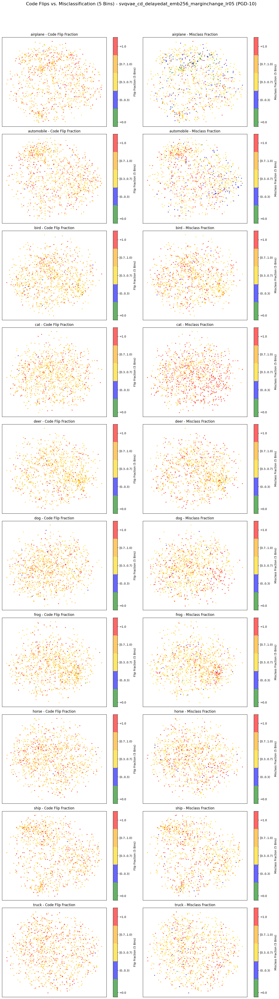

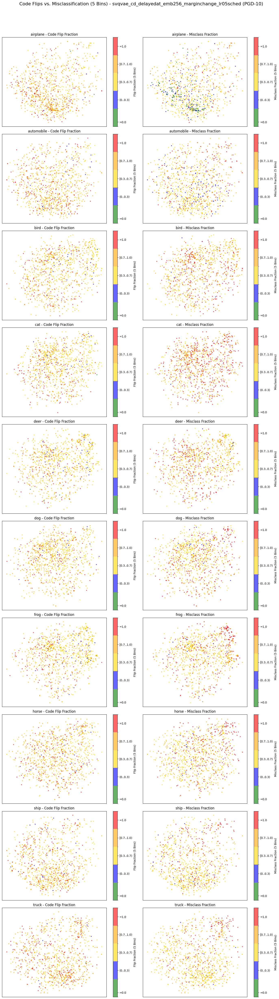

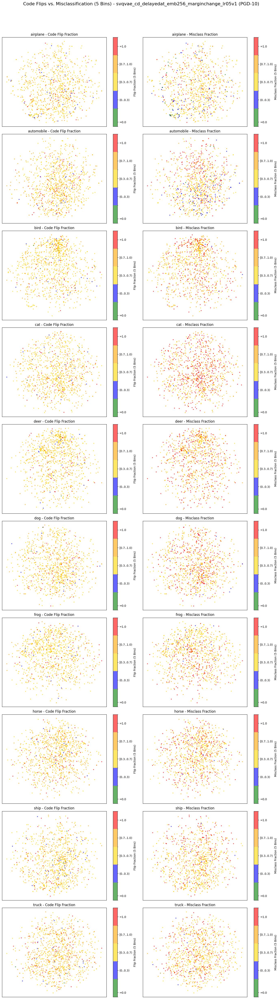

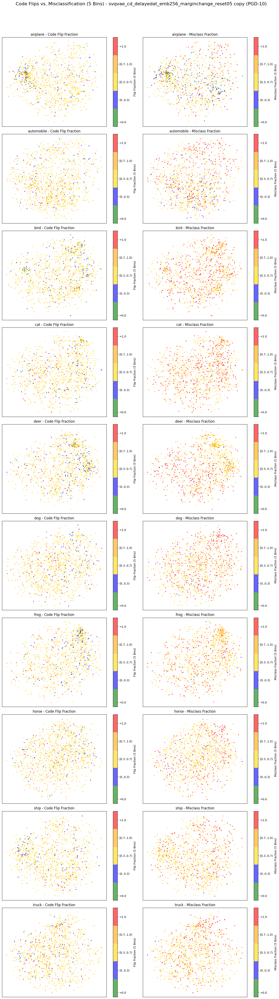

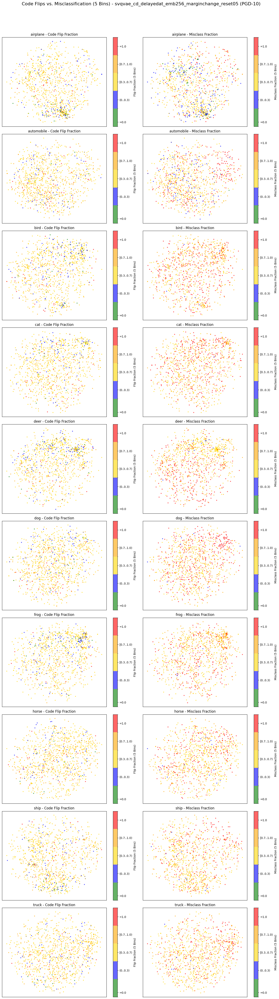

...

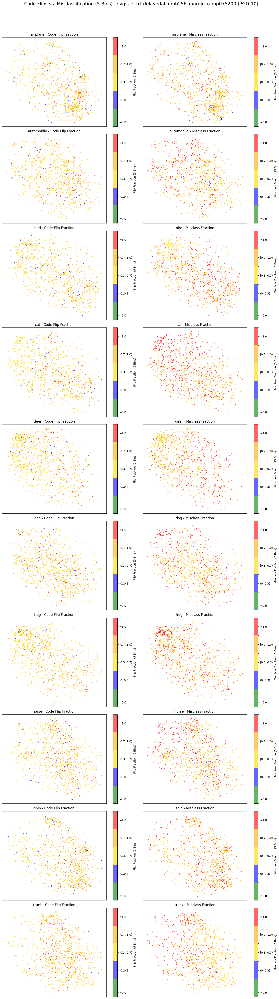

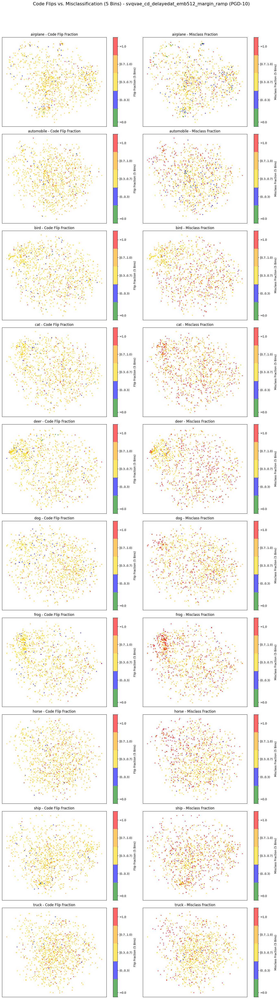

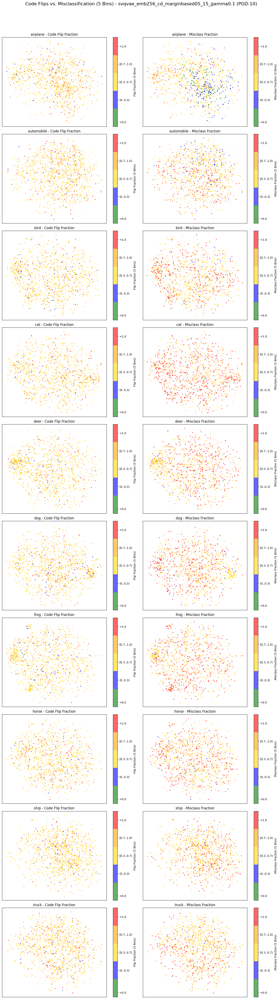

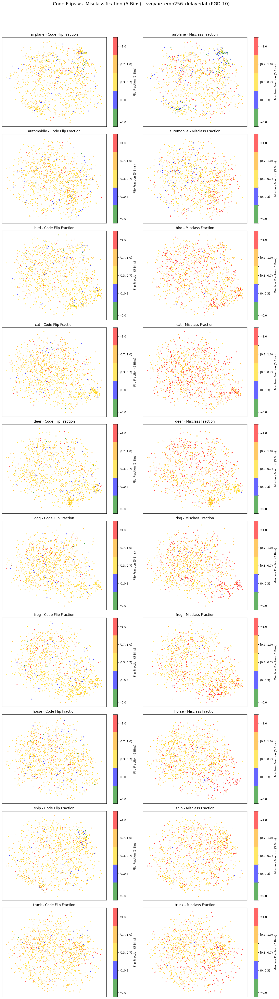

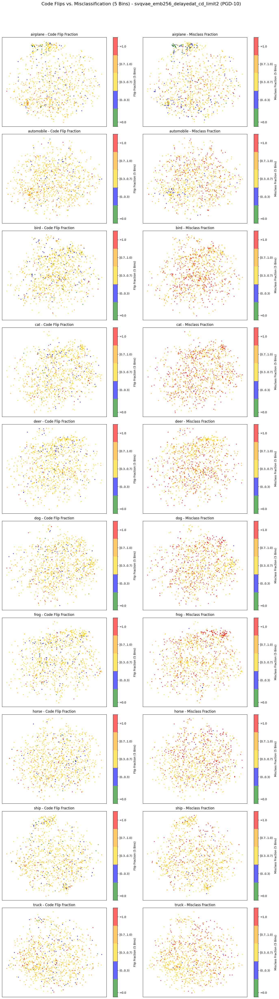

In [34]:
for model_name, model in models.items():
    visualize_flips_and_misclassification_discrete(
        model=model,
        data_loader=data_loader,
        model_name=model_name,
        attack_name='PGD-10',
        iters=10,
        eps=8/255,
        alpha=2/255
    )

In [ ]:
import numpy as np
import torch
import matplotlib.pyplot as plt
from sklearn.manifold import TSNE
import matplotlib.colors as mcolors

cifar10_label_names = [
    "airplane",
    "automobile",
    "bird",
    "cat",
    "deer",
    "dog",
    "frog",
    "horse",
    "ship",
    "truck"
]

# visualize codebook vectors with bin coloring comparing stability and missclassification
def visualize_code_usage_bars(
    model,
    data_loader,
    model_name,
    attack_name,
    track_flips_and_misclass, 
    n_classes=10,
    iters=10,
    eps=8/255,
    alpha=2/255
):

    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
    model.to(device)
    model.eval()

    # list of all final codes, flipFrac, misclassFrac, labels
    all_final_codes = []
    all_flip_fracs  = []
    all_mis_fracs   = []
    all_labels      = []

    # loop over the dataset
    for x_batch, labels in data_loader:
        x_batch, labels = x_batch.to(device), labels.to(device)

        flip_frac_batch, mis_frac_batch, x_adv_final = track_flips_and_misclass(
            model, x_batch, labels,
            iters=iters, eps=eps, alpha=alpha
        )

        with torch.no_grad():
            _, _, latent_codes = model.encode(x_adv_final)
        
        latent_codes_flat = latent_codes.view(latent_codes.size(0), -1)
        final_code_index = latent_codes_flat[:, 0].cpu().numpy().astype(int)

        all_final_codes.append(final_code_index)
        all_flip_fracs.append(flip_frac_batch)
        all_mis_fracs.append(mis_frac_batch)
        all_labels.append(labels.cpu().numpy())

    # concatenate everything
    all_final_codes = np.concatenate(all_final_codes, axis=0)  
    all_flip_fracs  = np.concatenate(all_flip_fracs, axis=0) 
    all_mis_fracs   = np.concatenate(all_mis_fracs, axis=0)  
    all_labels      = np.concatenate(all_labels, axis=0)    

    n_embed = model.quantize.n_embed
    n_rows = n_classes + 1  

    usage_counts  = np.zeros((n_rows, n_embed), dtype=np.int32)
    sum_flip_frac = np.zeros((n_rows, n_embed), dtype=np.float32)
    sum_mis_frac  = np.zeros((n_rows, n_embed), dtype=np.float32)

    for i in range(all_final_codes.shape[0]):
        code_idx = all_final_codes[i]
        lbl      = all_labels[i]
        flipf    = all_flip_fracs[i]
        misf     = all_mis_fracs[i]

        usage_counts[0, code_idx]  += 1
        sum_flip_frac[0, code_idx] += flipf
        sum_mis_frac[0, code_idx]  += misf

        usage_counts[lbl+1, code_idx]  += 1
        sum_flip_frac[lbl+1, code_idx] += flipf
        sum_mis_frac[lbl+1, code_idx]  += misf

    # compute average flip/misclassification fraction for each code
    avg_flip_frac = np.zeros((n_rows, n_embed), dtype=np.float32)
    avg_mis_frac  = np.zeros((n_rows, n_embed), dtype=np.float32)

    for r in range(n_rows):
        for c in range(n_embed):
            if usage_counts[r, c] > 0:
                avg_flip_frac[r, c] = sum_flip_frac[r, c] / usage_counts[r, c]
                avg_mis_frac[r, c]  = sum_mis_frac[r, c]  / usage_counts[r, c]
            else:
                avg_flip_frac[r, c] = 0.0
                avg_mis_frac[r, c]  = 0.0



    # build the 5-bin colormap & boundaries
    bounds = [-0.001, 0.0000001, 0.3, 0.7, 0.9999999, 1.001]
    colors = ['green', 'blue', 'gold', 'orange', 'red']
    discrete_cmap = mcolors.ListedColormap(colors, name='fivebin')
    norm = mcolors.BoundaryNorm(boundaries=bounds, ncolors=len(colors))

    fig, axes = plt.subplots(nrows=n_rows, ncols=2, figsize=(16, 4*n_rows))
    fig.suptitle(f"Code Usage (PGD Attack) - {model_name} ({attack_name})", fontsize=16)

    # label row 0 => "All Classes", row i => "Class i-1"
    row_titles = ["All Classes"] + [cifar10_label_names[i] for i in range(n_classes)]

    for r in range(n_rows):
        # left col => color by avg_flip_frac[r, :]
        ax_left = axes[r, 0] if n_rows>1 else axes[0]  # handle if n_rows=1
        # right col => color by avg_mis_frac[r, :]
        ax_right = axes[r, 1] if n_rows>1 else axes[1]

        x_vals = np.arange(n_embed)
        usage_vals = usage_counts[r, :]
        flip_vals  = avg_flip_frac[r, :]
        mis_vals   = avg_mis_frac[r, :]

        bars_left  = ax_left.bar(x_vals, usage_vals)
        bars_right = ax_right.bar(x_vals, usage_vals)

        # color each bar based on 5-bin logic
        for c_idx, bar in enumerate(bars_left):
            v = flip_vals[c_idx]
            color = discrete_cmap(norm(v))  
            bar.set_color(color)

        for c_idx, bar in enumerate(bars_right):
            v = mis_vals[c_idx]
            color = discrete_cmap(norm(v))
            bar.set_color(color)

        ax_left.set_title(f"{row_titles[r]} - Flip Fraction Color")
        ax_right.set_title(f"{row_titles[r]} - Misclass Fraction Color")

        ax_left.set_xlabel("Code Index")
        ax_right.set_xlabel("Code Index")
        ax_left.set_ylabel("Usage Count")

        # add colorbars for each subplot
        sm_left = plt.cm.ScalarMappable(cmap=discrete_cmap, norm=norm)
        sm_left.set_array([]) 
        cb_left = plt.colorbar(sm_left, ax=ax_left, boundaries=bounds)
        cb_left.set_ticks([-0.0005, 0.15, 0.5, 0.85, 1.0005])
        cb_left.set_ticklabels(["=0.0", "(0..0.3)", "[0.3..0.7)", "[0.7..1.0)", "=1.0"])
        cb_left.set_label("Flip Fraction Bins")

        sm_right = plt.cm.ScalarMappable(cmap=discrete_cmap, norm=norm)
        sm_right.set_array([])
        cb_right = plt.colorbar(sm_right, ax=ax_right, boundaries=bounds)
        cb_right.set_ticks([-0.0005, 0.15, 0.5, 0.85, 1.0005])
        cb_right.set_ticklabels(["=0.0", "(0..0.3)", "[0.3..0.7)", "[0.7..1.0)", "=1.0"])
        cb_right.set_label("Misclass Fraction Bins")


        ax_left.set_xticks(x_vals[:: max(1, n_embed//10)])  
        ax_right.set_xticks(x_vals[:: max(1, n_embed//10)])

    plt.tight_layout(rect=[0, 0, 1, 0.96])
    plt.show()

for model_name, model in models.items():
    visualize_code_usage_bars(
        model=model,
        data_loader=data_loader,
        model_name=model_name,
        attack_name="PGD-10",
        track_flips_and_misclass=track_flips_and_misclass,  
        iters=10,
        eps=8/255,
        alpha=2/255
    )


Vectors indicate clear disconnect between stability and misclassification. Let's compare fractions as a whole:

In [ ]:
import numpy as np
import torch
import matplotlib.pyplot as plt

cifar10_label_names = [
    "airplane", "automobile", "bird", "cat", "deer",
    "dog", "frog", "horse", "ship", "truck"
]

def visualize_flip_misclass_distributions(
    model, data_loader, model_name, attack_name,
    track_flips_and_misclass, n_classes=10, iters=10, eps=8/255, alpha=2/255
):
    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
    model.to(device)
    model.eval()
    
    # prepare bins for histogram
    bins = np.linspace(0, 1, 11) 
    bin_labels = [f"{b:.1f}" for b in bins[:-1]]  
    
    # store counts per class + total
    flip_counts = np.zeros((n_classes + 1, len(bins) - 1))
    mis_counts = np.zeros((n_classes + 1, len(bins) - 1))
    
    # loop over dataset
    for x_batch, labels in data_loader:
        x_batch, labels = x_batch.to(device), labels.to(device)

        flip_frac_batch, mis_frac_batch, _ = track_flips_and_misclass(
            model, x_batch, labels, iters=iters, eps=eps, alpha=alpha
        )
        
        # ensure correct format for numpy conversion
        if isinstance(flip_frac_batch, torch.Tensor):
            flip_frac_batch = flip_frac_batch.cpu().numpy()
        if isinstance(mis_frac_batch, torch.Tensor):
            mis_frac_batch = mis_frac_batch.cpu().numpy()
        if isinstance(labels, torch.Tensor):
            labels = labels.cpu().numpy()
        
        # histogram counts
        for i, lbl in enumerate(labels):
            flip_counts[lbl + 1] += np.histogram([flip_frac_batch[i]], bins=bins)[0]
            mis_counts[lbl + 1] += np.histogram([mis_frac_batch[i]], bins=bins)[0]
            flip_counts[0] += np.histogram([flip_frac_batch[i]], bins=bins)[0]  # Total
            mis_counts[0] += np.histogram([mis_frac_batch[i]], bins=bins)[0]  # Total
    
    # determine the maximum y-axis value per row
    max_counts = np.maximum(flip_counts.max(axis=1), mis_counts.max(axis=1))
    
    # plot results
    fig, axes = plt.subplots(nrows=n_classes + 1, ncols=1, figsize=(14, 4 * (n_classes + 1)))
    fig.suptitle(f"Flip and Misclassification Fraction Distributions - {model_name} ({attack_name})", fontsize=16)
    
    row_titles = ["All Classes"] + cifar10_label_names
    bar_width = 0.4 
    x = np.arange(len(bin_labels))
    
    for r in range(n_classes + 1):
        ax = axes[r]
        
        ax.bar(x - bar_width / 2, flip_counts[r], width=bar_width, color='royalblue', label='Flip Probability')
        ax.bar(x + bar_width / 2, mis_counts[r], width=bar_width, color='firebrick', label='Misclassification')
        
        ax.set_ylim(0, max_counts[r])
        ax.set_xticks(x)
        ax.set_xticklabels(bin_labels)
        
        ax.set_title(f"{row_titles[r]} - Flip & Misclassification Fraction Distribution")
        ax.set_xlabel("Fraction Bins")
        ax.set_ylabel("Count")
        ax.legend()
    
    plt.tight_layout(rect=[0, 0, 1, 0.96])
    plt.show()

for model_name, model in models.items():
    visualize_flip_misclass_distributions(
        model=model,
        data_loader=data_loader,
        model_name=model_name,
        attack_name="PGD-10",
        track_flips_and_misclass=track_flips_and_misclass,
        n_classes=10,
        iters=10,
        eps=8/255,
        alpha=2/255
    )
